https://dadosabertos.tse.jus.br/dataset/candidatos-2024
https://dadosabertos.tse.jus.br/dataset/candidatos-2020-subtemas

Alunos: 
Kamila Klein,
Fernando Luís Paludo,
Júlio Spezzia de Souza


Link do colab: https://colab.research.google.com/drive/1kgo1R7Q0TSXYG3YGxYxL1qs77yy0OphL?usp=sharing

CSV e mapas: https://drive.google.com/drive/folders/1jyBk8lOJNhfHIPdBm8twtm1f-r8c8kU5?usp=drive_link

In [2]:
%pip install PyPDF2 nltk
%pip install geopandas
%pip install nltk




Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.
Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.
Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [26]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import geopandas as gpd
import os
import PyPDF2
import nltk
import numpy as np
from collections import Counter
from nltk.corpus import stopwords



In [4]:
dados = pd.read_csv('merged_candidatos.csv', encoding='utf-8', sep = ",") #CSV personalizado aqui

In [5]:
dados = dados.drop_duplicates(subset='NM_CANDIDATO')

dados.head()

,SQ_CANDIDATO,SQ_COLIGACAO,NM_CANDIDATO,SG_PARTIDO,SG_UF,DS_COR_RACA,NM_UE,DS_CARGO,CD_SIT_TOT_TURNO,DS_COMPOSICAO_COLIGACAO,QTD_PARTIDOS,VR_BEM_CANDIDATO,DS_URL,REGIAO
0,250001131126,250000137139,RICARDO AKIRA ONO AURIANI,PSB,SP,AMARELA,RIO GRANDE DA SERRA,PREFEITO,-1,NaN,NaN,"40000,00",https://www.facebook.com/akiraaurianioficial,Sudeste
1,170000816060,170000084801,FABIO ANDRADE DE OLIVEIRA,PROS,PE,PARDA,JABOATÃO DOS GUARARAPES,VEREADOR,-1,PROS,1.0,NaN,NaN,Nordeste
2,170000665717,170000059564,EDILEUZA ROSA SILVA DO NASCIMENTO,PRTB,PE,PARDA,JABOATÃO DOS GUARARAPES,VEREADOR,-1,PRTB,1.0,NaN,NaN,Nordeste
3,150000982608,150000114825,LUCINEIDE GOMES DA SILVA,PV,PB,PARDA,JACARAÚ,VEREADOR,-1,PV,1.0,"1200,00",NaN,Nordeste
4,190000782716,190000076074,MARCILEA BRAGA MATOS,PSL,RJ,NÃO INFORMADO,TANGUÁ,VEREADOR,2,PSL,1.0,"26000,00",NaN,Sudeste


In [6]:
dados.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 529683 entries, 0 to 529682
Data columns (total 14 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   SQ_CANDIDATO             529683 non-null  int64  
 1   SQ_COLIGACAO             529683 non-null  int64  
 2   NM_CANDIDATO             529683 non-null  object 
 3   SG_PARTIDO               529683 non-null  object 
 4   SG_UF                    529683 non-null  object 
 5   DS_COR_RACA              529683 non-null  object 
 6   NM_UE                    529683 non-null  object 
 7   DS_CARGO                 529683 non-null  object 
 8   CD_SIT_TOT_TURNO         529683 non-null  int64  
 9   DS_COMPOSICAO_COLIGACAO  529439 non-null  object 
 10  QTD_PARTIDOS             529439 non-null  float64
 11  VR_BEM_CANDIDATO         323442 non-null  object 
 12  DS_URL                   180332 non-null  object 
 13  REGIAO                   529683 non-null  object 
dtypes: f

In [7]:
dados['QTD_PARTIDOS'].value_counts()

QTD_PARTIDOS
1.0     505236
2.0       9571
3.0       6210
4.0       3475
5.0       2107
6.0       1121
7.0        719
8.0        425
9.0        248
10.0       136
11.0        78
12.0        47
13.0        19
15.0        18
14.0        13
16.0         7
18.0         4
21.0         3
17.0         2
Name: count, dtype: int64

In [8]:
dados.columns



Index(['SQ_CANDIDATO', 'SQ_COLIGACAO', 'NM_CANDIDATO', 'SG_PARTIDO', 'SG_UF',
       'DS_COR_RACA', 'NM_UE', 'DS_CARGO', 'CD_SIT_TOT_TURNO',
       'DS_COMPOSICAO_COLIGACAO', 'QTD_PARTIDOS', 'VR_BEM_CANDIDATO', 'DS_URL',
       'REGIAO'],
      dtype='object')

1. O candidato eleito para prefeito (2020) é o que declarou maior quantidade de
bens (influência do poder econômico nas eleições)

In [9]:
dados.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 529683 entries, 0 to 529682
Data columns (total 14 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   SQ_CANDIDATO             529683 non-null  int64  
 1   SQ_COLIGACAO             529683 non-null  int64  
 2   NM_CANDIDATO             529683 non-null  object 
 3   SG_PARTIDO               529683 non-null  object 
 4   SG_UF                    529683 non-null  object 
 5   DS_COR_RACA              529683 non-null  object 
 6   NM_UE                    529683 non-null  object 
 7   DS_CARGO                 529683 non-null  object 
 8   CD_SIT_TOT_TURNO         529683 non-null  int64  
 9   DS_COMPOSICAO_COLIGACAO  529439 non-null  object 
 10  QTD_PARTIDOS             529439 non-null  float64
 11  VR_BEM_CANDIDATO         323442 non-null  object 
 12  DS_URL                   180332 non-null  object 
 13  REGIAO                   529683 non-null  object 
dtypes: f

In [10]:
dados['VR_BEM_CANDIDATO'] = dados['VR_BEM_CANDIDATO'].str.replace(',', '').astype(float)
prefeitos = dados[dados['DS_CARGO'] == 'PREFEITO']

media_prefeitos = prefeitos['VR_BEM_CANDIDATO'].mean()
media_demais = dados[dados['DS_CARGO'] != 'PREFEITO']['VR_BEM_CANDIDATO'].mean()

print(f'Média dos bens dos prefeitos: {media_prefeitos}')
print(f'Média dos bens dos demais candidatos: {media_demais}')

eleitos_prefeitos = prefeitos[prefeitos['CD_SIT_TOT_TURNO'].isin([1, 2, 3])]
eleitos_mais_ricos = eleitos_prefeitos.nlargest(5, 'VR_BEM_CANDIDATO')

print("Prefeitos eleitos com maiores valores de bens:")
print(eleitos_mais_ricos[['NM_CANDIDATO', 'VR_BEM_CANDIDATO']])


Média dos bens dos prefeitos: 43101824.29076832
Média dos bens dos demais candidatos: 6053805.075567745
Prefeitos eleitos com maiores valores de bens:
                      NM_CANDIDATO  VR_BEM_CANDIDATO
316871             LUIZ CARLOS GIL      2.547435e+09
505397       ROBERTO SOARES PESSOA      1.009233e+09
395356      MOACIR LUIZ GIACOMELLI      9.000000e+08
498579  JOSÉ MARIO ZAMBON TEIXEIRA      9.000000e+08
84138              FERNANDO GORGEN      4.522501e+08


In [11]:
dados['ELEITO'] = dados['CD_SIT_TOT_TURNO'].isin([1, 2, 3]).astype(int)
correlacao = dados['VR_BEM_CANDIDATO'].corr(dados['ELEITO'])

print(f'Correlação entre valor dos bens e eleição: {correlacao}')
print('\nA correlação foi baixa.')

Correlação entre valor dos bens e eleição: -0.0011174129484623635

A correlação foi baixa.


2. As maiores coligações (em número de partidos) foram as que mais ganharam
disputas?

In [12]:
agrupamento = dados.groupby('QTD_PARTIDOS')['ELEITO'].mean()

print("Média de candidatos eleitos por quantidade de partidos na coligação:")
print(agrupamento)
print("Parece que há uma correlação entre as coligações maiores e a porcentagem de candidatos eleitos. \nNo entando, é importante salientar, que há uma quantidade muito maior de candidatos em coligações menores, o que pode ter influenciado nos resultados apresentados.")


Média de candidatos eleitos por quantidade de partidos na coligação:
QTD_PARTIDOS
1.0     0.111835
2.0     0.301849
3.0     0.393237
4.0     0.465036
5.0     0.491694
6.0     0.512935
7.0     0.532684
8.0     0.595294
9.0     0.544355
10.0    0.669118
11.0    0.653846
12.0    0.659574
13.0    0.842105
14.0    0.769231
15.0    0.777778
16.0    1.000000
17.0    1.000000
18.0    1.000000
21.0    0.666667
Name: ELEITO, dtype: float64
Parece que há uma correlação entre as coligações maiores e a porcentagem de candidatos eleitos. 
No entando, é importante salientar, que há uma quantidade muito maior de candidatos em coligações menores, o que pode ter influenciado nos resultados apresentados.


3. Qual partido tem a maior quantidade de candidatos por UF?

In [13]:
frequencia_partidos = dados.groupby(['SG_UF', 'SG_PARTIDO']).size().reset_index(name='QTD_CANDIDATOS')

partidos_mais_candidatos = frequencia_partidos.loc[frequencia_partidos.groupby('SG_UF')['QTD_CANDIDATOS'].idxmax()]

print("Tabela com maiores partidos por estado: \n")
partidos_mais_candidatos

Tabela com maiores partidos por estado: 



,SG_UF,SG_PARTIDO,QTD_CANDIDATOS
4,AC,MDB,321
31,AL,MDB,1163
85,AM,REPUBLICANOS,860
90,AP,DEM,196
135,BA,PSD,4869
159,CE,PDT,2158
200,ES,PSB,1014
217,GO,DEM,2443
255,MA,PDT,1772
281,MG,MDB,5764


4. Existe uma tendência regional para maior número de candidaturas por partido?


In [14]:
pd.set_option('display.max_rows', None)

frequencia_partidos_ue = dados.groupby(['NM_UE', 'SG_PARTIDO']).size().reset_index(name='QTD_CANDIDATOS')

partidos_mais_candidatos_ue = frequencia_partidos_ue.loc[frequencia_partidos_ue.groupby('NM_UE')['QTD_CANDIDATOS'].idxmax()]
print("Tabela com partido com maior quantidade de candidatos por zona eleitoral: \n")
partidos_mais_candidatos_ue


Tabela com partido com maior quantidade de candidatos por zona eleitoral: 



,NM_UE,SG_PARTIDO,QTD_CANDIDATOS
5,ABADIA DE GOIÁS,PP,15
10,ABADIA DOS DOURADOS,DEM,11
15,ABADIÂNIA,MDB,15
35,ABAETETUBA,PSDB,25
43,ABAETÉ,DEM,15
51,ABAIARA,PT,15
52,ABARÉ,DEM,15
61,ABATIÁ,PROS,14
65,ABAÍRA,DEM,14
71,ABDON BATISTA,PSD,12


5. Qual o maior partido por UF em termos de candidatos
(Prefeito+Vice+Vereadores)

In [15]:
dados['DS_CARGO'].value_counts()

DS_CARGO
VEREADOR         492045
VICE-PREFEITO     18919
PREFEITO          18719
Name: count, dtype: int64

In [16]:
frequencia_partidos = dados.groupby(['SG_UF', 'SG_PARTIDO']).size().reset_index(name='QTD_CANDIDATOS')

partidos_mais_candidatos = frequencia_partidos.loc[frequencia_partidos.groupby('SG_UF')['QTD_CANDIDATOS'].idxmax()]
print("É redundante com a questão 5. \n")
print(partidos_mais_candidatos)


É redundante com a questão 5. 

    SG_UF     SG_PARTIDO  QTD_CANDIDATOS
4      AC            MDB             321
31     AL            MDB            1163
85     AM   REPUBLICANOS             860
90     AP            DEM             196
135    BA            PSD            4869
159    CE            PDT            2158
200    ES            PSB            1014
217    GO            DEM            2443
255    MA            PDT            1772
281    MG            MDB            5764
329    MS           PSDB            1072
340    MT            DEM            1226
370    PA            MDB            2239
399    PB      CIDADANIA            1322
447    PE            PSB            2133
477    PI             PP            1856
514    PR            PSD            3705
557    RJ   REPUBLICANOS            1405
564    RN            MDB            1173
596    RO            MDB             521
648    RR  SOLIDARIEDADE             168
663    RS             PP            5237
686    SC            MDB 

6. Qual a região que mais registrou candidatos Indígenas e Quilombolas?

In [17]:
print(dados['DS_COR_RACA'].value_counts())
print("\nComo não há especificamente quilombolas, vou fazer indígenas e pretos. \n")

DS_COR_RACA
BRANCA            256818
PARDA             208200
PRETA              54436
NÃO INFORMADO       6037
INDÍGENA            2135
AMARELA             1894
NÃO DIVULGÁVEL       163
Name: count, dtype: int64

Como não há especificamente quilombolas, vou fazer indígenas e pretos. 



In [18]:
indigenas_por_regiao = dados[dados['DS_COR_RACA'] == 'INDÍGENA'].groupby('REGIAO').size()
pretos_por_regiao = dados[dados['DS_COR_RACA'] == 'PRETA'].groupby('REGIAO').size()

print("Candidatos indígenas registrados por região:")
print(indigenas_por_regiao)
print("\nCandidatos pretos registrados por região:")
print(pretos_por_regiao)

Candidatos indígenas registrados por região:
REGIAO
Centro-Oeste    356
Nordeste        477
Norte           918
Sudeste         156
Sul             228
dtype: int64

Candidatos pretos registrados por região:
REGIAO
Centro-Oeste     4061
Nordeste        17541
Norte            5003
Sudeste         23251
Sul              4580
dtype: int64


7. Qual a rede social preferida dos candidatos? Separe por partido e por UF.

In [19]:
print(dados['DS_URL'].value_counts())

DS_URL
FACEBOOK                                                                                                                               735
facebook                                                                                                                               401
INSTAGRAM                                                                                                                              178
WHATSAPP                                                                                                                               169
Facebook                                                                                                                               168
www.pco.org.br                                                                                                                         125
whatsapp                                                                                                                               108
https://www.instagra

In [20]:
redes_sociais = ['facebook', 'twitter', 'instagram', 'linkedin', 'youtube']
email_keywords = ['email', 'mail']

def identificar_rede_social(url):
    if pd.isna(url):
        return 'outras'
    url_lower = str(url).lower()
    for rede in redes_sociais:
        if rede in url_lower:
            return rede
    for keyword in email_keywords:
        if keyword in url_lower:
            return 'email'
    return 'outras'

dados_rede = dados.dropna(subset=['DS_URL']).copy()
dados_rede['REDE_SOCIAL'] = dados_rede['DS_URL'].apply(identificar_rede_social)
frequencia_rede_social = dados_rede.groupby(['SG_UF', 'SG_PARTIDO', 'REDE_SOCIAL']).size().reset_index(name='QTD_CANDIDATOS')
def filtrar_top_rede(grupo):
    return grupo.loc[grupo['QTD_CANDIDATOS'].idxmax()]

top_rede_social = frequencia_rede_social.groupby(['SG_UF', 'SG_PARTIDO']).apply(filtrar_top_rede).reset_index(drop=True)

print("Redes sociais mais usadas por partido e UF: \n",top_rede_social)

Redes sociais mais usadas por partido e UF: 
     SG_UF     SG_PARTIDO REDE_SOCIAL  QTD_CANDIDATOS
0      AC         AVANTE   instagram               1
1      AC      CIDADANIA    facebook              20
2      AC            DEM    facebook              22
3      AC            MDB    facebook              21
4      AC        PC do B      outras               9
5      AC            PCB   instagram               1
6      AC            PCO      outras               1
7      AC            PDT       email              34
8      AC             PP    facebook              17
9      AC           PROS      outras               7
10     AC            PSB       email              18
11     AC            PSC    facebook               8
12     AC            PSD    facebook              37
13     AC           PSDB      outras              10
14     AC            PSL    facebook               1
15     AC           PSOL    facebook               4
16     AC             PT      outras              17


8. Utilize técnicas de NLP para determinar quais os principais termos (propostas)
presentes nos planos de governo de SC.

In [21]:

nltk.download('stopwords')

pdf_folder = 'SC' #Colocar folder com os pdf's de SC

word_counts = Counter()
stop_words = set(stopwords.words('portuguese'))
additional_stopwords = {"municipio", "municipal", "cidade", "s", "r", "programa", "município"}

def extract_text_from_pdf(pdf_path):
    with open(pdf_path, 'rb') as file:
        reader = PyPDF2.PdfReader(file)
        text = ''
        for page in range(len(reader.pages)):
            text += reader.pages[page].extract_text()
    return text

for pdf_file in os.listdir(pdf_folder):
    if pdf_file.endswith('.pdf'):
        pdf_path = os.path.join(pdf_folder, pdf_file)
        text = extract_text_from_pdf(pdf_path)
        words = text.split()
        filtered_words = [word.lower() for word in words if word.isalpha() and word.lower() not in stop_words and word.lower() not in additional_stopwords]
        word_counts.update(filtered_words)

most_common_words = word_counts.most_common(10)
print(most_common_words)


[nltk_data] Downloading package stopwords to
[nltk_data]     /home/vandelsoncleitoso/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
Multiple definitions in dictionary at byte 0xedc97 for key /Info
Multiple definitions in dictionary at byte 0xedca4 for key /Info
Multiple definitions in dictionary at byte 0xedcb1 for key /Info


[('saúde', 7620), ('atendimento', 6388), ('ampliar', 6064), ('desenvolvimento', 5876), ('plano', 5559), ('educação', 5536), ('promover', 5290), ('criar', 5251), ('ações', 5112), ('programas', 4841)]


Pelo resultado anterior, percebe-se que o foco se concentra na educação, provavelmente ampliando a capacidade dos hospitais e melhorando o atendimento.
Fora isso, temos 'desenvolvimento', que provavelemente se refere à melhorias de infraestrutura.
Por fim, temos 'educação', que é também uma preocupação comum, visto que o sistema de educação Brasileiro é muito criticado pelo povo.

9. Baixe os dados totalizados da eleição de 2020, utilize uma cor para cada
partido, e crie um mapa colorido para cada UF do Brasil, pintando o município
de acordo com a legenda do partido vencedor no município. Você pode colocar
uma “bolinha” ou marcador na cidade com a cor desejada (use a biblioteca
folium para isso).
a. https://www.ibge.gov.br/geociencias/organizacao-do-territorio/malhasterritoriais/15774-malhas.html
b. https://www.alura.com.br/conteudo/dados-geograficos-visualizacao-mapas-folium?srsltid=AfmBOopqsBtY5OEnmnTZVhlvj18DZioEd6Fj2knjh5gjKemTI08K5yHJ

In [22]:
dados.columns

Index(['SQ_CANDIDATO', 'SQ_COLIGACAO', 'NM_CANDIDATO', 'SG_PARTIDO', 'SG_UF',
       'DS_COR_RACA', 'NM_UE', 'DS_CARGO', 'CD_SIT_TOT_TURNO',
       'DS_COMPOSICAO_COLIGACAO', 'QTD_PARTIDOS', 'VR_BEM_CANDIDATO', 'DS_URL',
       'REGIAO', 'ELEITO'],
      dtype='object')

In [23]:
print(dados['SG_PARTIDO'].value_counts())

SG_PARTIDO
MDB              43052
PSD              37839
PP               36870
DEM              31614
PSDB             31537
PT               30179
PDT              27549
REPUBLICANOS     27343
PL               27086
PSB              25563
PTB              22664
PSL              21033
PODE             19655
PSC              17241
CIDADANIA        16515
SOLIDARIEDADE    16248
AVANTE           14450
PATRIOTA         13651
PV               11642
PROS             11262
PC do B          10156
PRTB              7576
PTC               6458
PMN               4788
DC                4664
REDE              4615
PSOL              4546
PMB               2717
NOVO               611
PSTU               196
PCO                134
UP                 131
PCB                 75
UNIÃO               22
PRD                  1
Name: count, dtype: int64


/tmp/ipykernel_8374/673311221.py:7: FutureWarning: The provided callable <built-in function max> is currently using SeriesGroupBy.max. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "max" instead.
  idx = grouped.groupby(['NM_UE'])['counts'].transform(max) == grouped['counts']
/tmp/ipykernel_8374/673311221.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  most_elected['NM_UE'] = most_elected['NM_UE'].str.upper()
/tmp/ipykernel_8374/673311221.py:27: UserWarning: Only specify one of 'column' or 'color'. Using 'color'.
  mapa_brasil.plot(column='SG_PARTIDO', color=mapa_brasil['color'], legend=True, ax=ax, missing_kwds={"color": "lightgrey", "label": "No Data"})


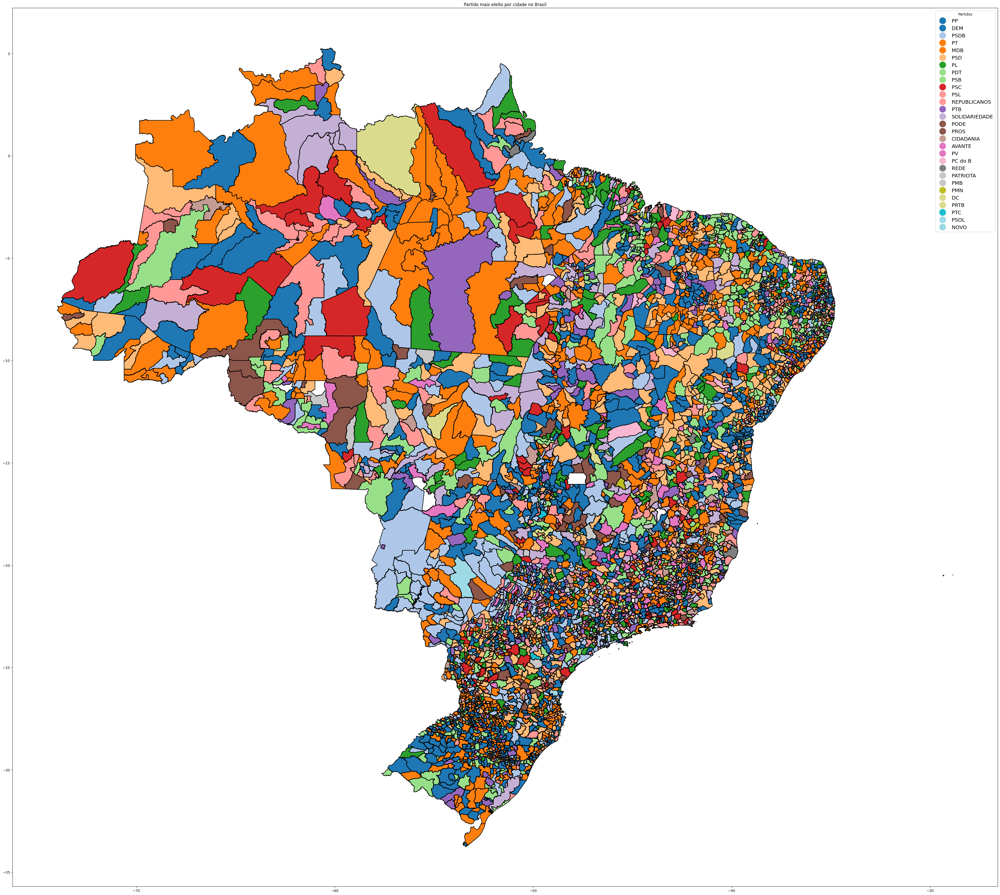

In [32]:
mapa_brasil = gpd.read_file('mapa/BR_Municipios_2022.shp') #colocar aqui arquivo do mapa

mapa_brasil['NM_MUN'] = mapa_brasil['NM_MUN'].str.upper().str.normalize('NFKD').str.encode('ascii', errors='ignore').str.decode('utf-8')
dados['NM_UE'] = dados['NM_UE'].str.upper().str.normalize('NFKD').str.encode('ascii', errors='ignore').str.decode('utf-8')

grouped = dados[dados['ELEITO'] == 1].groupby(['NM_UE', 'SG_PARTIDO']).size().reset_index(name='counts')
idx = grouped.groupby(['NM_UE'])['counts'].transform(max) == grouped['counts']
most_elected = grouped[idx]
most_elected['NM_UE'] = most_elected['NM_UE'].str.upper()
mapa_brasil = mapa_brasil.merge(most_elected, left_on='NM_MUN', right_on='NM_UE', how='left')

parties = most_elected['SG_PARTIDO'].unique()

n_colors_needed = len(parties)
base_cmap = plt.get_cmap('tab20')  
extended_cmap = base_cmap(np.linspace(0, 1, n_colors_needed))  

color_dict = {party: extended_cmap[i % len(extended_cmap)] for i, party in enumerate(parties)}


mapa_brasil['color'] = mapa_brasil['SG_PARTIDO'].map(color_dict)
# Filter out NaN values
mapa_brasil = mapa_brasil.dropna(subset=['color'])

fig, ax = plt.subplots(1, 1, figsize=(50, 50))
mapa_brasil.boundary.plot(ax=ax, edgecolor = 'black')
mapa_brasil.plot(column='SG_PARTIDO', color=mapa_brasil['color'], legend=True, ax=ax, missing_kwds={"color": "lightgrey", "label": "No Data"})

handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color_dict[party], markersize=20) for party in parties]
labels = parties
ax.legend(handles, labels, title='Partidos', fontsize='x-large') 

plt.title('Partido mais eleito por cidade no Brasil')
plt.show()



In [25]:
print(mapa_brasil.columns)

Index(['CD_MUN', 'NM_MUN', 'SIGLA_UF', 'AREA_KM2', 'geometry', 'NM_UE',
       'SG_PARTIDO', 'counts', 'color'],
      dtype='object')
